In [ ]:
!pip install xgboost
!pip install folium

In [454]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import os
main_df = pd.read_csv('Food_Inspections_and_Violations.csv')
complaint_df = pd.read_csv('311_Service_Requests_Sanitation_Code_Complaints_No_Duplicates.csv')
#https://data.cityofchicago.org/Service-Requests/311-Service-Requests-Sanitation-Code-Complaints-No/rccf-5427/data
rodent_df = pd.read_csv('311_Service_Requests_Rodent_Baiting_No_Duplicates.csv')
#https://data.cityofchicago.org/Service-Requests/311-Service-Requests-Rodent-Baiting-No-Duplicates/uqhs-j723/data
temperature_df = pd.read_csv('ncei_noaa_govaccesspast_weatherchicago.csv')
#https://github.com/zonination/weather-us/blob/master/chicago.csv

In [455]:
import folium
import folium.plugins as plugins
main_df_all=main_df.dropna(subset=['Latitude','Longitude'])
Long=main_df_all.Longitude.mean()
Lat=main_df_all.Latitude.mean()
main_df_all_map=folium.Map([Lat,Long],zoom_start=12)

main_df_all_distribution_map=plugins.MarkerCluster().add_to(main_df_all_map)
for lat,lon,label in list(set(zip(main_df_all.Latitude,main_df_all.Longitude,main_df_all['DBA Name']))):
    folium.Marker(location=[lat,lon],icon=None,popup=label).add_to(main_df_all_distribution_map)
main_df_all_map.add_child(main_df_all_distribution_map)

main_df_all_map

In [456]:
main_df.columns

Index(['Inspection ID', 'DBA Name', 'AKA Name', 'License #', 'Facility Type',
       'Risk', 'Address', 'City', 'State', 'Zip', 'Inspection Date',
       'Inspection Type', 'Results', 'Violations', 'Latitude', 'Longitude',
       'Location'],
      dtype='object')

Our predicting target should be "Results" but only a subset which includes 'Fail' , 'Pass w/ Conditions' , 'Pass'.    

Since hierarchical relationship exists between above three types (Fail< Pass w/ Conditions < Pass), muticlassification is not ideal.     

For more detailed illustration, think about scenario that the model falsely predict "Fail" cases as "Pass w/ Conditions",    
it should be more tolerable than the model mistakenly predict "Fail" cases as "Pass"! This will be taken care of by regression.    

However, if muticlassification is chosen, it will treat the false predictions of "Fail" cases equally.      
It can not differentiate between "Pass w/ Conditions" and "Pass", it only sees "Fail" and "Not Fail".    
That's how softmax works, it will not punish false prediction of "Fail" as "Pass" harder than false prediction of "Fail" as "Pass w/ Conditions".   

Thus regression is being adopted with  Fail=0 , Pass w/ Conditions =1 , and Pass =2.

In [457]:
len(main_df.drop_duplicates()),len(main_df)

(135742, 135742)

In [459]:
main_df=main_df[main_df["Results"].isin(["Fail","Pass","Pass w/ Conditions"])]

Text(0, 0.5, 'LATITUDE')

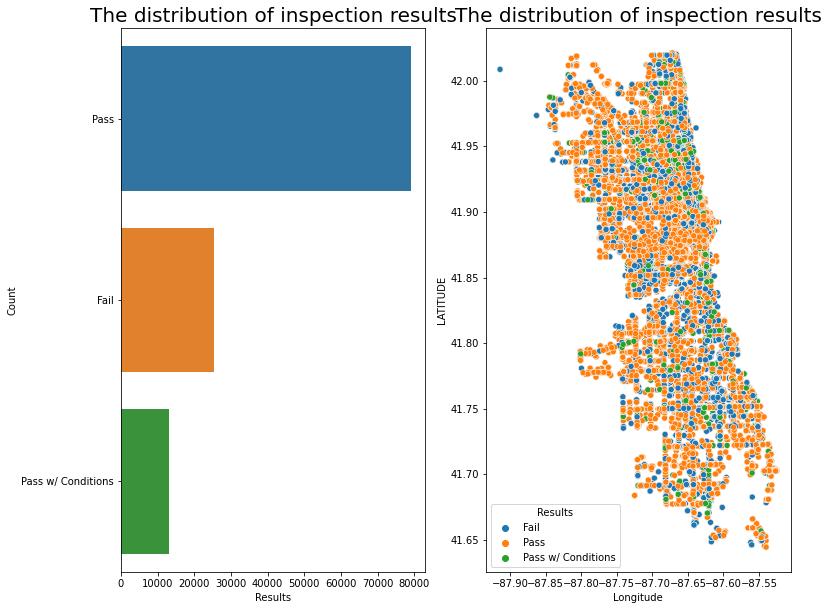

In [472]:
fig,ax=plt.subplots(1,2,figsize=(12,10))
sns.barplot(x=main_df["Results"].value_counts(),y=main_df["Results"].value_counts().index,ax=ax[0])
ax[0].set_title("The distribution of inspection results",size=20)
ax[0].set_xlabel('Results')
ax[0].set_ylabel('Count')

sns.scatterplot(x='Longitude',y='Latitude',hue='Results',hue_order=["Fail","Pass","Pass w/ Conditions"] ,data=main_df, ax=ax[1])
ax[1].set_title("The distribution of inspection results",size=20)
ax[1].set_xlabel('Longitude')
ax[1].set_ylabel('LATITUDE')

In [473]:
main_df["Inspection Date"]=pd.to_datetime(main_df["Inspection Date"])
print(main_df["Results"].value_counts())
main_df.head()

Pass                  79053
Fail                  25341
Pass w/ Conditions    13105
Name: Results, dtype: int64


,Inspection ID,DBA Name,AKA Name,License #,Facility Type,Risk,Address,City,State,Zip,Inspection Date,Inspection Type,Results,Violations,Latitude,Longitude,Location
0,2079132,MARRIOT MARQUIS CHICAGO,MARRIOT MARQUIS CHICAGO,2517328.0,Restaurant,Risk 1 (High),2121 S PRAIRIE AVE,CHICAGO,IL,60616.0,2017-08-28,License,Pass,NaN,41.853651,-87.620534,"(41.853650885040594, -87.62053358114167)"
3,2079123,MARRIOT MARQUIS CHICAGO,MARRIOT MARQUIS CHICAGO,2517338.0,Restaurant,Risk 1 (High),2121 S PRAIRIE AVE,CHICAGO,IL,60616.0,2017-08-28,License,Pass,"35. WALLS, CEILINGS, ATTACHED EQUIPMENT CONSTR...",41.853651,-87.620534,"(41.853650885040594, -87.62053358114167)"
4,2079105,CHARTWELLS,CICS WEST BELDEN CAMPUS,2549079.0,CHARTER SCHOOL,Risk 1 (High),2245 N MCVICKER AVE,CHICAGO,IL,60639.0,2017-08-28,License Re-Inspection,Pass,18. NO EVIDENCE OF RODENT OR INSECT OUTER OPEN...,41.921675,-87.776711,"(41.921675488910864, -87.7767113569357)"
5,2079104,SHRIMP'S FISH CHICKEN,SHRIMP'S FISH CHICKEN,2549497.0,Restaurant,Risk 2 (Medium),4355 S COTTAGE GROVE AVE,CHICAGO,IL,60653.0,2017-08-28,License,Fail,2. FACILITIES TO MAINTAIN PROPER TEMPERATURE -...,41.815197,-87.606531,"(41.81519729173754, -87.60653088909952)"
6,2079091,ART'S DRIVE INN,ART'S DRIVE INN,64682.0,Restaurant,Risk 1 (High),1333 W NORTH AVE,CHICAGO,IL,60622.0,2017-08-25,Canvass,Fail,2. FACILITIES TO MAINTAIN PROPER TEMPERATURE -...,41.910601,-87.661863,"(41.910600662840906, -87.66186347385191)"


In [474]:
# 79053+25341+13105=117499
print(main_df["Facility Type"].value_counts()[:10])
print(main_df["Facility Type"].value_counts()[:10]/main_df.shape[0])

Restaurant                         79821
Grocery Store                      15825
School                              7998
Bakery                              1780
Daycare (2 - 6 Years)               1685
Children's Services Facility        1480
Daycare Above and Under 2 Years     1353
Long Term Care                       707
Catering                             650
Mobile Food Dispenser                569
Name: Facility Type, dtype: int64
Restaurant                         0.679333
Grocery Store                      0.134682
School                             0.068069
Bakery                             0.015149
Daycare (2 - 6 Years)              0.014341
Children's Services Facility       0.012596
Daycare Above and Under 2 Years    0.011515
Long Term Care                     0.006017
Catering                           0.005532
Mobile Food Dispenser              0.004843
Name: Facility Type, dtype: float64


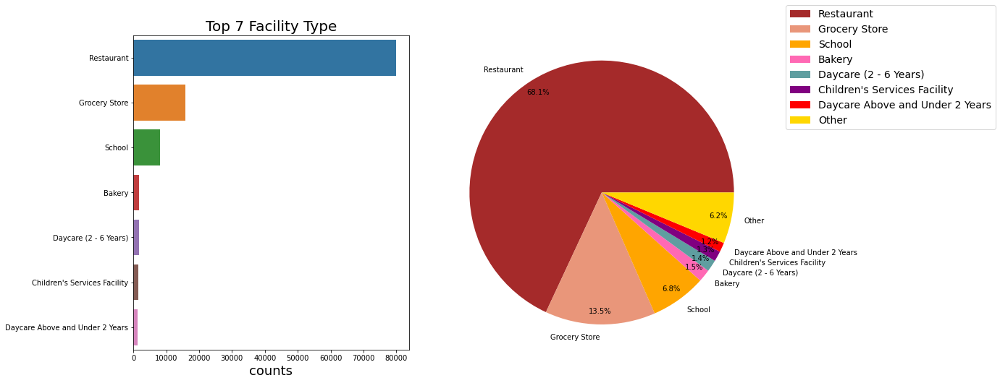

In [475]:
fig,ax=plt.subplots(1,2,figsize=(15,8))
sns.barplot(x=main_df['Facility Type'].value_counts()[:7],y=main_df['Facility Type'].value_counts()[:7].index,ax=ax[0])
ax[0].set_title("Top 7 Facility Type",size=20)
ax[0].set_xlabel('counts',size=18)


count=main_df.groupby(['Facility Type'])['Inspection ID'].agg('count').sort_values(ascending=False)
groups=list(main_df.groupby(['Facility Type'])['Inspection ID'].agg('count').sort_values(ascending=False).index[:7])
counts=list(count[:7])
counts.append(count.agg(sum)-count[:7].agg('sum'))
groups.append('Other')
type_dict=pd.DataFrame({"group":groups,"counts":counts})
clr1=('brown','darksalmon','orange','hotpink','cadetblue','purple','red','gold','forestgreen','blue','plum')
type_dict.plot(kind='pie', y='counts', labels=groups,colors=clr1,autopct='%1.1f%%', pctdistance=0.9, radius=1.2,ax=ax[1])
ax[1].set_ylabel('')
ax[1].legend(loc=0, ncol=1, fontsize=14,bbox_to_anchor=(1.15,1.2))

In [476]:
df1=main_df.groupby(['Facility Type'])['Inspection ID'].agg('count').reset_index().sort_values(by=['Facility Type']).rename(columns={'Inspection ID':'counts_total'})
df2=main_df.groupby(['Facility Type','Results'])['Inspection ID'].agg('count').reset_index().sort_values(by=['Facility Type','Results']).rename(columns={'Inspection ID':'counts'})
df2=pd.merge(df2,df1,on='Facility Type',how='inner')

In [477]:
df2=df2.sort_values(by=['counts_total'],ascending=False)
df2["rate"]=df2["counts"]/df2["counts_total"]
df2.head()

,Facility Type,Results,counts,counts_total,rate
555,Restaurant,Pass w/ Conditions,10179,79821,0.127523
553,Restaurant,Fail,16410,79821,0.205585
554,Restaurant,Pass,53232,79821,0.666892
319,Grocery Store,Pass w/ Conditions,1545,15825,0.097630
318,Grocery Store,Pass,10148,15825,0.641264


In [478]:
df3=df2[df2["Facility Type"].isin(main_df["Facility Type"].value_counts()[:7].index)]
df3_fail=df3[df3["Results"]=="Fail"].sort_values(by=['rate'],ascending=False)
df3_pass_w=df3[df3["Results"]=="Pass w/ Conditions"].sort_values(by=['rate'],ascending=False)
df3_pass=df3[df3["Results"]=="Pass"].sort_values(by=['rate'],ascending=False)

In [479]:
df3_fail

,Facility Type,Results,counts,counts_total,rate
317,Grocery Store,Fail,4132,15825,0.261106
61,Bakery,Fail,416,1780,0.233708
553,Restaurant,Fail,16410,79821,0.205585
582,School,Fail,1612,7998,0.201550
207,Daycare (2 - 6 Years),Fail,336,1685,0.199407
164,Children's Services Facility,Fail,285,1480,0.192568
215,Daycare Above and Under 2 Years,Fail,247,1353,0.182557


Text(0.5, 0, 'pass rates')

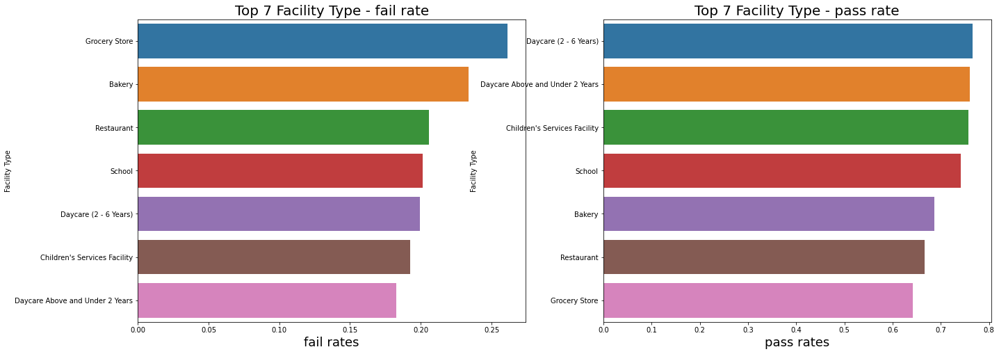

In [480]:
#fail rates by facility
#pass with conditions rates by facility
fig,ax=plt.subplots(1,2,figsize=(22,8))
sns.barplot(x=df3_fail['rate'],y=df3_fail['Facility Type'],ax=ax[0])
ax[0].set_title("Top 7 Facility Type - fail rate",size=20)
ax[0].set_xlabel('fail rates',size=18)

sns.barplot(x=df3_pass['rate'],y=df3_pass["Facility Type"],ax=ax[1])
ax[1].set_title("Top 7 Facility Type - pass rate",size=20)
ax[1].set_xlabel('pass rates',size=18)



As can be observed in the above graph, facilities related to children and kids has less fail rates, might due to reason that they have more sense of responsibility and potentially under supervision of parents

In [481]:
fac_list=list(main_df["Facility Type"].value_counts()[:7].index)
#only preserve top 7 categories, the rest are grouped into "other"
main_df["Facility Type"]=np.where(main_df["Facility Type"].isin(fac_list),main_df["Facility Type"],"other")

print(main_df["Risk"].value_counts())
main_df=main_df[main_df["Risk"].isin(["Risk 1 (High)","Risk 2 (Medium)","Risk 3 (Low)"])]

print(main_df["Inspection Type"].value_counts()[:10])
print(main_df["Inspection Type"].value_counts()[:10]/main_df.shape[0])

Risk 1 (High)      85359
Risk 2 (Medium)    23879
Risk 3 (Low)        8237
All                    5
Name: Risk, dtype: int64
Canvass                     57911
License                     16183
Canvass Re-Inspection       14253
Complaint                   11561
License Re-Inspection        5599
Complaint Re-Inspection      4916
Short Form Complaint         4679
Suspected Food Poisoning      473
Consultation                  410
License-Task Force            366
Name: Inspection Type, dtype: int64
Canvass                     0.492964
License                     0.137757
Canvass Re-Inspection       0.121328
Complaint                   0.098412
License Re-Inspection       0.047661
Complaint Re-Inspection     0.041847
Short Form Complaint        0.039830
Suspected Food Poisoning    0.004026
Consultation                0.003490
License-Task Force          0.003116
Name: Inspection Type, dtype: float64


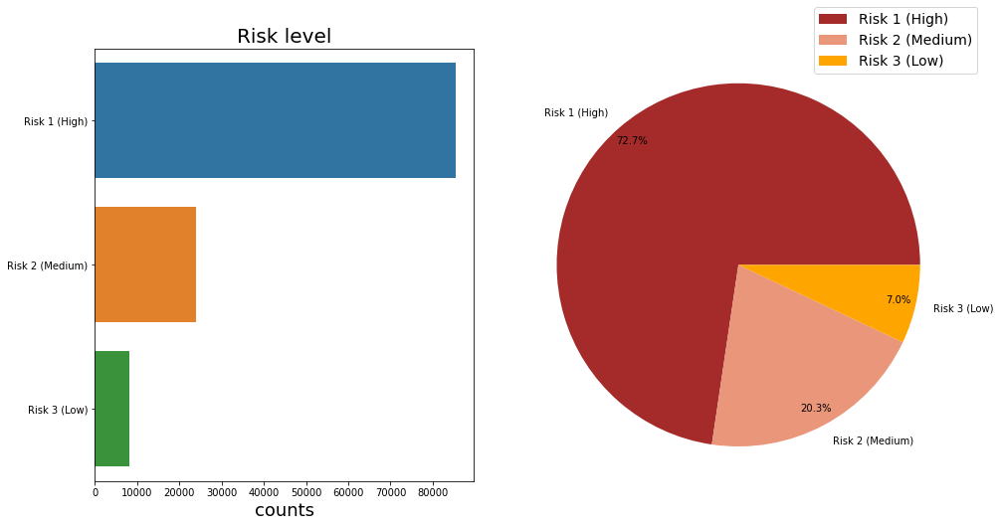

In [482]:
fig,ax=plt.subplots(1,2,figsize=(15,8))
sns.barplot(x=main_df['Risk'].value_counts(),y=main_df['Risk'].value_counts().index,ax=ax[0])
ax[0].set_title("Risk level",size=20)
ax[0].set_xlabel('counts',size=18)


count=main_df.groupby(['Risk'])['Inspection ID'].agg('count').sort_values(ascending=False)
groups=list(main_df.groupby(['Risk'])['Inspection ID'].agg('count').sort_values(ascending=False).index)
counts=list(count)
type_dict=pd.DataFrame({"group":groups,"counts":counts})
clr1=('brown','darksalmon','orange','hotpink','cadetblue','purple','red','gold','forestgreen','blue','plum')
type_dict.plot(kind='pie', y='counts', labels=groups,colors=clr1,autopct='%1.1f%%', pctdistance=0.9, radius=1.2,ax=ax[1])
ax[1].set_ylabel('')
ax[1].legend(loc=0, ncol=1, fontsize=14,bbox_to_anchor=(1.15,1.2))

In [483]:
df1=main_df.groupby(['Risk'])['Inspection ID'].agg('count').reset_index().sort_values(by=['Risk']).rename(columns={'Inspection ID':'counts_total'})
df2=main_df.groupby(['Risk','Results'])['Inspection ID'].agg('count').reset_index().sort_values(by=['Risk','Results']).rename(columns={'Inspection ID':'counts'})
df2=pd.merge(df2,df1,on='Risk',how='inner')
df2=df2.sort_values(by=['counts_total'],ascending=False)
df2["rate"]=df2["counts"]/df2["counts_total"]
df3=df2[df2["Risk"].isin(main_df["Risk"].value_counts().index)]
df3_fail=df3[df3["Results"]=="Fail"].sort_values(by=['rate'],ascending=False)
df3_pass_w=df3[df3["Results"]=="Pass w/ Conditions"].sort_values(by=['rate'],ascending=False)
df3_pass=df3[df3["Results"]=="Pass"].sort_values(by=['rate'],ascending=False)

Text(0.5, 0, 'pass rates')

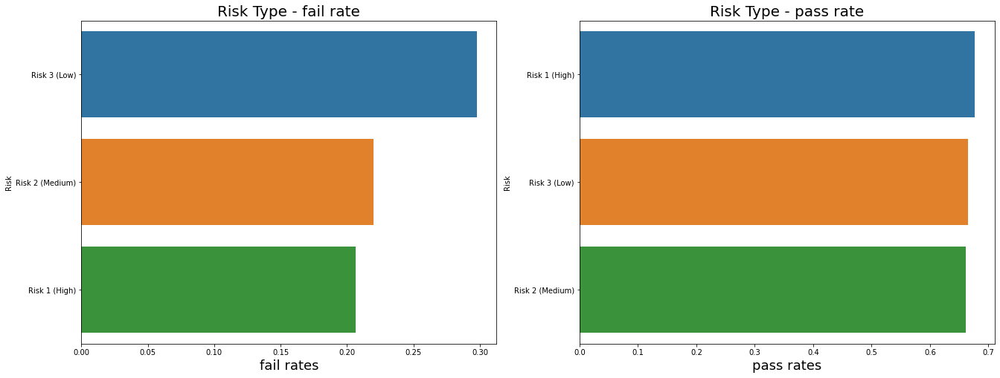

In [484]:
#fail rates by facility
#pass with conditions rates by facility
fig,ax=plt.subplots(1,2,figsize=(22,8))
sns.barplot(x=df3_fail['rate'],y=df3_fail['Risk'],ax=ax[0])
ax[0].set_title("Risk Type - fail rate",size=20)
ax[0].set_xlabel('fail rates',size=18)

sns.barplot(x=df3_pass['rate'],y=df3_pass["Risk"],ax=ax[1])
ax[1].set_title("Risk Type - pass rate",size=20)
ax[1].set_xlabel('pass rates',size=18)


Expected risk level to be positively correlates with fail rates, however, fail to find such relationship from grapgh above

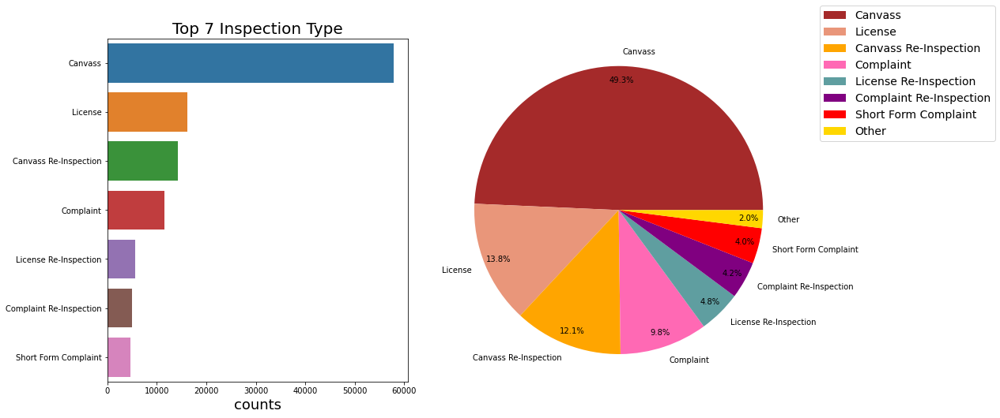

In [485]:
fig,ax=plt.subplots(1,2,figsize=(15,8))
sns.barplot(x=main_df['Inspection Type'].value_counts()[:7],y=main_df['Inspection Type'].value_counts()[:7].index,ax=ax[0])
ax[0].set_title("Top 7 Inspection Type",size=20)
ax[0].set_xlabel('counts',size=18)


count=main_df.groupby(['Inspection Type'])['Inspection ID'].agg('count').sort_values(ascending=False)
groups=list(main_df.groupby(['Inspection Type'])['Inspection ID'].agg('count').sort_values(ascending=False).index[:7])
counts=list(count[:7])
counts.append(count.agg(sum)-count[:7].agg('sum'))
groups.append('Other')
type_dict=pd.DataFrame({"group":groups,"counts":counts})
clr1=('brown','darksalmon','orange','hotpink','cadetblue','purple','red','gold','forestgreen','blue','plum')
type_dict.plot(kind='pie', y='counts', labels=groups,colors=clr1,autopct='%1.1f%%', pctdistance=0.9, radius=1.2,ax=ax[1])
ax[1].set_ylabel('')
ax[1].legend(loc=0, ncol=1, fontsize=14,bbox_to_anchor=(1.15,1.2))

In [486]:
df1=main_df.groupby(['Inspection Type'])['Inspection ID'].agg('count').reset_index().sort_values(by=['Inspection Type']).rename(columns={'Inspection ID':'counts_total'})
df2=main_df.groupby(['Inspection Type','Results'])['Inspection ID'].agg('count').reset_index().sort_values(by=['Inspection Type','Results']).rename(columns={'Inspection ID':'counts'})
df2=pd.merge(df2,df1,on='Inspection Type',how='inner')
df2=df2.sort_values(by=['counts_total'],ascending=False)
df2["rate"]=df2["counts"]/df2["counts_total"]
df2.head()

,Inspection Type,Results,counts,counts_total,rate
8,Canvass,Pass w/ Conditions,8081,57911,0.139542
6,Canvass,Fail,12323,57911,0.212792
7,Canvass,Pass,37507,57911,0.647666
31,License,Pass,9882,16183,0.610641
32,License,Pass w/ Conditions,389,16183,0.024038


In [487]:
df3=df2[df2["Inspection Type"].isin(main_df["Inspection Type"].value_counts()[:7].index)]
df3_fail=df3[df3["Results"]=="Fail"].sort_values(by=['rate'],ascending=False)
df3_pass_w=df3[df3["Results"]=="Pass w/ Conditions"].sort_values(by=['rate'],ascending=False)
df3_pass=df3[df3["Results"]=="Pass"].sort_values(by=['rate'],ascending=False)

Text(0.5, 0, 'pass rates')

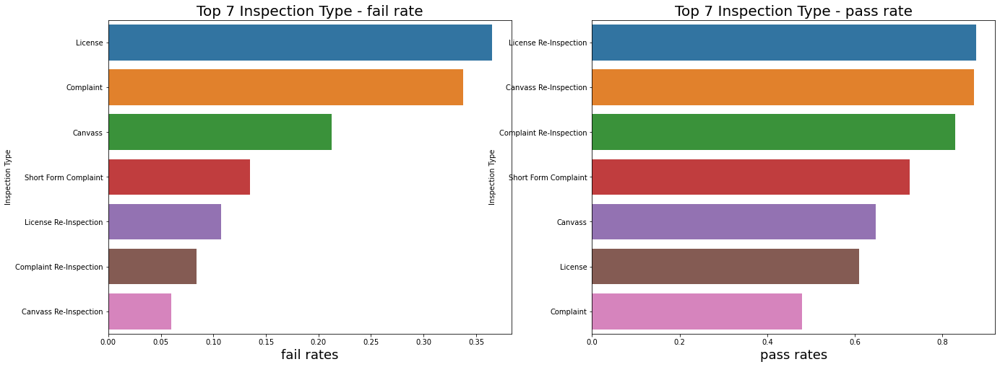

In [488]:
#fail rates by facility
#pass with conditions rates by facility
fig,ax=plt.subplots(1,2,figsize=(22,8))
sns.barplot(x=df3_fail['rate'],y=df3_fail['Inspection Type'],ax=ax[0])
ax[0].set_title("Top 7 Inspection Type - fail rate",size=20)
ax[0].set_xlabel('fail rates',size=18)

sns.barplot(x=df3_pass['rate'],y=df3_pass["Inspection Type"],ax=ax[1])
ax[1].set_title("Top 7 Inspection Type - pass rate",size=20)
ax[1].set_xlabel('pass rates',size=18)



Re-inspections has significantly less fail rates, that is intuitive since people tend to value their "second chance" and correct past mistakes for the incoming re-inspection

In [489]:
ins_list=list(main_df["Inspection Type"].value_counts()[:7].index)
#only preserve top 7 categories, the rest are grouped into "other"
main_df["Inspection Type"]=np.where(main_df["Inspection Type"].isin(ins_list),main_df["Inspection Type"],"other")

In [490]:
main_df["Violations"].head()

0                                                  NaN
3    35. WALLS, CEILINGS, ATTACHED EQUIPMENT CONSTR...
4    18. NO EVIDENCE OF RODENT OR INSECT OUTER OPEN...
5    2. FACILITIES TO MAINTAIN PROPER TEMPERATURE -...
6    2. FACILITIES TO MAINTAIN PROPER TEMPERATURE -...
Name: Violations, dtype: object

In [491]:
print(main_df["Violations"][3])
re.findall(r'\d+\. ',main_df["Violations"][3])

35. WALLS, CEILINGS, ATTACHED EQUIPMENT CONSTRUCTED PER CODE: GOOD REPAIR, SURFACES CLEAN AND DUST-LESS CLEANING METHODS - Comments: MUST PROVIDE OVERHEAD PROTECTION FOR COFFEE/TEA STATION OUTSIDE OF BALLROOM ON 4TH FL. AND ON 2ND FL. OUTSIDE OF BANQUET KITCHEN IN COORIDOR.  | 34. FLOORS: CONSTRUCTED PER CODE, CLEANED, GOOD REPAIR, COVING INSTALLED, DUST-LESS CLEANING METHODS USED - Comments: FLOORS AT COFFEE/TEA STATIONS MUST BE MADE SMOOTH AND EASILY CLEANABLE.


['35. ', '34. ']

To extract the specific number of violations mention for each time, following function will be applied, but note that current violation could not be used as predictor but only previous violation could, otherwise would lead to data leakage.

In [492]:
def extract_violation(x):
    temp_list=[]
    for i in re.findall(r'\d+\. ',x):
        temp_list.append(int(i[:-2]))
    return temp_list


In [493]:
main_df["Violations_bool"]=np.where(main_df["Violations"].isnull(),0,1)
main_df["Violations"].fillna("",inplace=True)
main_df["violations_list"]=main_df["Violations"].apply(lambda x: extract_violation(x))

In [494]:
main_df["violations_len"]=main_df["violations_list"].apply(lambda x: len(x))

In [495]:
main_df.head()

,Inspection ID,DBA Name,AKA Name,License #,Facility Type,Risk,Address,City,State,Zip,Inspection Date,Inspection Type,Results,Violations,Latitude,Longitude,Location,Violations_bool,violations_list,violations_len
0,2079132,MARRIOT MARQUIS CHICAGO,MARRIOT MARQUIS CHICAGO,2517328.0,Restaurant,Risk 1 (High),2121 S PRAIRIE AVE,CHICAGO,IL,60616.0,2017-08-28,License,Pass,,41.853651,-87.620534,"(41.853650885040594, -87.62053358114167)",0,[],0
3,2079123,MARRIOT MARQUIS CHICAGO,MARRIOT MARQUIS CHICAGO,2517338.0,Restaurant,Risk 1 (High),2121 S PRAIRIE AVE,CHICAGO,IL,60616.0,2017-08-28,License,Pass,"35. WALLS, CEILINGS, ATTACHED EQUIPMENT CONSTR...",41.853651,-87.620534,"(41.853650885040594, -87.62053358114167)",1,"[35, 34]",2
4,2079105,CHARTWELLS,CICS WEST BELDEN CAMPUS,2549079.0,other,Risk 1 (High),2245 N MCVICKER AVE,CHICAGO,IL,60639.0,2017-08-28,License Re-Inspection,Pass,18. NO EVIDENCE OF RODENT OR INSECT OUTER OPEN...,41.921675,-87.776711,"(41.921675488910864, -87.7767113569357)",1,"[18, 31, 34, 38, 41]",5
5,2079104,SHRIMP'S FISH CHICKEN,SHRIMP'S FISH CHICKEN,2549497.0,Restaurant,Risk 2 (Medium),4355 S COTTAGE GROVE AVE,CHICAGO,IL,60653.0,2017-08-28,License,Fail,2. FACILITIES TO MAINTAIN PROPER TEMPERATURE -...,41.815197,-87.606531,"(41.81519729173754, -87.60653088909952)",1,"[2, 11, 21, 22, 30, 32, 33, 34, 35, 37, 38, 41]",12
6,2079091,ART'S DRIVE INN,ART'S DRIVE INN,64682.0,Restaurant,Risk 1 (High),1333 W NORTH AVE,CHICAGO,IL,60622.0,2017-08-25,Canvass,Fail,2. FACILITIES TO MAINTAIN PROPER TEMPERATURE -...,41.910601,-87.661863,"(41.910600662840906, -87.66186347385191)",1,"[2, 3, 29, 90, 35, 33, 32, 38]",8


In [496]:
violations_dict={}
for i in main_df["violations_list"]:
    for j in i:
        if j in violations_dict:
            violations_dict[j]+=1
        else:
            violations_dict[j]=1

In [497]:
count_df=pd.DataFrame(violations_dict,index=["count"]).T.sort_values(by="count",ascending=False)
count_df["percentage"]=count_df["count"]/count_df["count"].sum()
print(count_df.shape[0])
count_df.head(30)

1007


,count,percentage
34,65240,0.124915
33,57757,0.110587
35,57525,0.110143
38,49551,0.094875
32,48907,0.093642
41,31169,0.059679
18,24502,0.046914
36,23552,0.045095
30,18782,0.035962
40,14853,0.028439


In [498]:
print(main_df[main_df["violations_list"].apply(lambda x: 34 in x)]["Results"].value_counts(normalize=True))
1-main_df[main_df["violations_list"].apply(lambda x: 34 in x)]["Results"].value_counts(normalize=True)[0]

Pass                  0.651759
Fail                  0.233956
Pass w/ Conditions    0.114285
Name: Results, dtype: float64


0.34824146489954577

In [499]:
fail_rate_list=[]
for i in count_df.index[:30]:
    fail_rate_list.append(main_df[main_df["violations_list"].apply(lambda x: i in x)]["Results"].value_counts(normalize=True)[1])
subset_count_df=count_df.head(30)
subset_count_df["fail_rate"]=fail_rate_list

C:\Users\87032\AppData\Local\Temp\ipykernel_20088\857272037.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset_count_df["fail_rate"]=fail_rate_list


In [500]:
print(subset_count_df["percentage"].sum())
subset_count_df.sort_values(by="fail_rate",ascending=False)
#18. NO EVIDENCE OF RODENT OR INSECT OUTER OPENINGS PROTECTED/RODENT PROOFED, A WRITTEN LOG SHALL BE MAINTAINED AVAILABLE TO THE INSPECTORS
#29. PREVIOUS MINOR VIOLATION(S) CORRECTED 7-42-090
#24. DISH WASHING FACILITIES: PROPERLY DESIGNED, CONSTRUCTED, MAINTAINED, INSTALLED, LOCATED AND OPERATED
#19. OUTSIDE GARBAGE WASTE GREASE AND STORAGE AREA; CLEAN, RODENT PROOF, ALL CONTAINERS COVERED
#3. POTENTIALLY HAZARDOUS FOOD MEETS TEMPERATURE REQUIREMENT DURING STORAGE, PREPARATION DISPLAY AND SERVICE
#12. HAND WASHING FACILITIES: WITH SOAP AND SANITARY HAND DRYING DEVICES, CONVENIENT AND ACCESSIBLE TO FOOD PREP AREA
#21. * CERTIFIED FOOD MANAGER ON SITE WHEN POTENTIALLY HAZARDOUS FOODS ARE  PREPARED AND SERVED
#16. FOOD PROTECTED DURING STORAGE, PREPARATION, DISPLAY, SERVICE AND TRANSPORTATION

0.9677890000478676


,count,percentage,fail_rate
18,24502,0.046914,0.424267
29,9049,0.017326,0.405110
8,2590,0.004959,0.403407
24,4612,0.008831,0.402865
19,5915,0.011325,0.396239
3,7179,0.013746,0.396134
26,2072,0.003967,0.395360
12,5299,0.010146,0.393137
21,9496,0.018182,0.350785
2,6615,0.012666,0.335822


According to fail_rate could split the violation code to 3 tiers     
tier_0: 18, 29, 8, 24, 19, 3, 26, 12    
tier_1: 21, 2, 11, 16, 9, 14, 37, 30    
tier_2: 41, 36, 40, 38, 35, 32, 43, 45, 34, 31, 33, 42


In [501]:
tier_0 = [18, 29, 8, 24, 19, 3, 26, 12]
tier_1  = [21, 2, 11, 16, 9, 14, 37, 30]    
tier_2 = [41, 36, 40, 38, 35, 32, 43, 45, 34, 31, 33, 42]
main_df["violations_tier_0"]=main_df["violations_list"].apply(lambda x: len(set(x).intersection(set(tier_0))) if len(set(x).intersection(set(tier_0)))>0 else 0)
main_df["violations_tier_1"]=main_df["violations_list"].apply(lambda x: len(set(x).intersection(set(tier_1))) if len(set(x).intersection(set(tier_1)))>0 else 0)
main_df["violations_tier_2"]=main_df["violations_list"].apply(lambda x: len(set(x).intersection(set(tier_2))) if len(set(x).intersection(set(tier_2)))>0 else 0)
#only violations_tier_0, violations_tier_1, violations_tier_2 are used in the model since it embedded the information of violations_len and is more granular


Add average highest temparture of past 2 days including today for each day

In [502]:
temperature_df["Date"]=pd.to_datetime(temperature_df["Date"])
temperature_df["TMAX (Degrees Fahrenheit)"]=temperature_df["TMAX (Degrees Fahrenheit)"].fillna(method="ffill")
temperature_df["Rolling_3_tmax"]=temperature_df["TMAX (Degrees Fahrenheit)"].rolling(3).mean().round(1)
temperature_subset_df=temperature_df[["Date","Rolling_3_tmax"]].copy()

In [503]:
temperature_df.head()

,Date,TAVG (Degrees Fahrenheit),TMAX (Degrees Fahrenheit),TMIN (Degrees Fahrenheit),PRCP (Inches),SNOW (Inches),SNWD (Inches),Rolling_3_tmax
0,2000-11-17,31.0,34.0,28.0,0.00,0.1,NaN,NaN
1,2000-11-18,29.0,35.0,23.0,0.00,NaN,NaN,NaN
2,2000-11-19,33.0,43.0,23.0,0.02,NaN,NaN,37.3
3,2000-11-20,25.0,29.0,20.0,0.00,0.3,0.0,35.7
4,2000-11-21,21.0,25.0,16.0,0.00,NaN,NaN,32.3


In [504]:
main_df=pd.merge(main_df,temperature_subset_df,left_on="Inspection Date",right_on="Date",how="inner")
main_df.drop(columns=["Date"],inplace=True)
print(main_df["Rolling_3_tmax"].isna().sum())

0


In [505]:
main_df.groupby(["Results"])["Rolling_3_tmax"].agg(["mean","median","std"])

,mean,median,std
Results,,,
Fail,62.592576,65.3,19.919408
Pass,61.414394,63.7,19.998213
Pass w/ Conditions,62.229063,65.0,20.324231


Though it is not obvious, from the stats we could see as 3 days average highest temperature goes up, the inspection fail chance tend to  increases.

<AxesSubplot:xlabel='Rolling_3_tmax', ylabel='Results'>

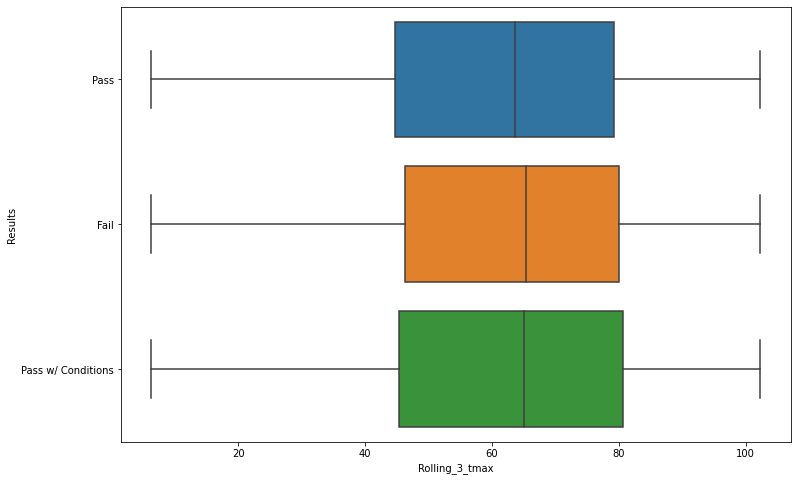

In [506]:
fig, ax = plt.subplots(figsize=(12,8))
sns.boxplot(data=main_df, x="Rolling_3_tmax", y="Results")

In [507]:
main_df.head()

,Inspection ID,DBA Name,AKA Name,License #,Facility Type,Risk,Address,City,State,Zip,...,Latitude,Longitude,Location,Violations_bool,violations_list,violations_len,violations_tier_0,violations_tier_1,violations_tier_2,Rolling_3_tmax
0,2079132,MARRIOT MARQUIS CHICAGO,MARRIOT MARQUIS CHICAGO,2517328.0,Restaurant,Risk 1 (High),2121 S PRAIRIE AVE,CHICAGO,IL,60616.0,...,41.853651,-87.620534,"(41.853650885040594, -87.62053358114167)",0,[],0,0,0,0,78.3
1,2079123,MARRIOT MARQUIS CHICAGO,MARRIOT MARQUIS CHICAGO,2517338.0,Restaurant,Risk 1 (High),2121 S PRAIRIE AVE,CHICAGO,IL,60616.0,...,41.853651,-87.620534,"(41.853650885040594, -87.62053358114167)",1,"[35, 34]",2,0,0,2,78.3
2,2079105,CHARTWELLS,CICS WEST BELDEN CAMPUS,2549079.0,other,Risk 1 (High),2245 N MCVICKER AVE,CHICAGO,IL,60639.0,...,41.921675,-87.776711,"(41.921675488910864, -87.7767113569357)",1,"[18, 31, 34, 38, 41]",5,1,0,4,78.3
3,2079104,SHRIMP'S FISH CHICKEN,SHRIMP'S FISH CHICKEN,2549497.0,Restaurant,Risk 2 (Medium),4355 S COTTAGE GROVE AVE,CHICAGO,IL,60653.0,...,41.815197,-87.606531,"(41.81519729173754, -87.60653088909952)",1,"[2, 11, 21, 22, 30, 32, 33, 34, 35, 37, 38, 41]",12,0,5,6,78.3
4,2079091,ART'S DRIVE INN,ART'S DRIVE INN,64682.0,Restaurant,Risk 1 (High),1333 W NORTH AVE,CHICAGO,IL,60622.0,...,41.910601,-87.661863,"(41.910600662840906, -87.66186347385191)",1,"[2, 3, 29, 90, 35, 33, 32, 38]",8,2,1,4,75.7


count how many recent(past 2 months) Sanitation Code Violations in surrounding area(same zipcode) of the establishments

In [508]:
complaint_df.head()

,Creation Date,Status,Completion Date,Service Request Number,Type of Service Request,What is the Nature of this Code Violation?,Street Address,ZIP Code,X Coordinate,Y Coordinate,Ward,Police District,Community Area,Latitude,Longitude,Location
0,09/17/2017,Completed,10/11/2017,17-06208608,Sanitation Code Violation,Overflowing carts,6327 S KENNETH AVE,60629.0,1.147796e+06,1.862217e+06,13.0,8.0,65.0,41.777870,-87.733727,"(41.777870228985, -87.733727348463)"
1,10/05/2017,Completed,10/11/2017,17-06678788,Sanitation Code Violation,Garbage in alley,3020 W MONTROSE AVE,60618.0,1.155359e+06,1.929085e+06,33.0,17.0,14.0,41.961214,-87.704204,"(41.961214454745, -87.704204220358)"
2,08/21/2017,Completed,10/11/2017,17-05591233,Sanitation Code Violation,Garbage in yard,1500 S DAMEN AVE,60608.0,1.163280e+06,1.892714e+06,28.0,12.0,28.0,41.861249,-87.676109,"(41.861249025322, -87.676108920835)"
3,09/23/2017,Completed,10/11/2017,17-06370432,Sanitation Code Violation,Construction Site Cleanliness/Fence,6442 S CENTRAL AVE,60638.0,1.140197e+06,1.861188e+06,13.0,8.0,64.0,41.775189,-87.761614,"(41.775189032012, -87.761613831651)"
4,09/26/2017,Completed,10/11/2017,17-06440193,Sanitation Code Violation,Other,8830 S WABASH AVE,60619.0,1.178255e+06,1.846460e+06,9.0,6.0,44.0,41.733996,-87.622542,"(41.733996131385, -87.622541895911)"


In [509]:
complaint_df["Creation Date"]=pd.to_datetime(complaint_df["Creation Date"])

In [510]:
print(max(complaint_df["Creation Date"]),min(complaint_df["Creation Date"]))
complaint_num_df=complaint_df.groupby(["ZIP Code","Creation Date"])["Service Request Number"].count().reset_index().sort_values(by=["ZIP Code","Creation Date"])
complaint_num_df.head(10)

2018-12-18 00:00:00 2000-01-03 00:00:00


,ZIP Code,Creation Date,Service Request Number
0,0.0,2011-02-11,1
1,0.0,2011-02-14,1
2,60601.0,2011-03-01,1
3,60601.0,2011-03-13,1
4,60601.0,2011-05-12,1
5,60601.0,2011-06-23,1
6,60601.0,2011-07-12,1
7,60601.0,2011-07-18,1
8,60601.0,2011-08-09,1
9,60601.0,2011-08-16,1


In [511]:
complaint_num_df=complaint_num_df.groupby("ZIP Code").resample("D",on="Creation Date")["Service Request Number"].sum().reset_index()

In [512]:
complaint_num_df.set_index("Creation Date",inplace=True)
complaint_num_df=complaint_num_df.sort_index()

In [513]:
complaint_num_df=complaint_num_df.groupby(["ZIP Code"]).rolling("60D")["Service Request Number"].sum().reset_index()
complaint_num_df.head(20)

,ZIP Code,Creation Date,Service Request Number
0,0.0,2011-02-11,1.0
1,0.0,2011-02-12,1.0
2,0.0,2011-02-13,1.0
3,0.0,2011-02-14,2.0
4,60601.0,2011-03-01,1.0
5,60601.0,2011-03-02,1.0
6,60601.0,2011-03-03,1.0
7,60601.0,2011-03-04,1.0
8,60601.0,2011-03-05,1.0
9,60601.0,2011-03-06,1.0


In [514]:
main_df=pd.merge(main_df,complaint_num_df,left_on=["Zip","Inspection Date"],right_on=["ZIP Code","Creation Date"],how="left")

In [515]:
main_df.columns

Index(['Inspection ID', 'DBA Name', 'AKA Name', 'License #', 'Facility Type',
       'Risk', 'Address', 'City', 'State', 'Zip', 'Inspection Date',
       'Inspection Type', 'Results', 'Violations', 'Latitude', 'Longitude',
       'Location', 'Violations_bool', 'violations_list', 'violations_len',
       'violations_tier_0', 'violations_tier_1', 'violations_tier_2',
       'Rolling_3_tmax', 'ZIP Code', 'Creation Date',
       'Service Request Number'],
      dtype='object')

In [516]:
main_df=main_df.drop(columns=["Inspection ID","ZIP Code","Creation Date","License #","City","State",'Latitude', 'Longitude'])

In [517]:
main_df[main_df["Service Request Number"].isna()]["Zip"].value_counts().head(10)

60666.0    886
60603.0     73
60604.0     70
60601.0     57
60602.0     42
60193.0     14
60007.0     12
60153.0     11
60611.0      9
60661.0      8
Name: Zip, dtype: int64

In [518]:
len(main_df[main_df["Service Request Number"].isna()]["Zip"].value_counts().index)

49

In [519]:
code_set_fillna={}
count=0
medianall=main_df["Service Request Number"].median()
for i in main_df[main_df["Service Request Number"].isna()]["Zip"].value_counts().index:
    if i not in complaint_num_df["ZIP Code"].unique():
        count+=1
        code_set_fillna[i]=medianall
    else:
        code_set_fillna[i]=0
print(count)
print(code_set_fillna)

37
{60666.0: 0, 60603.0: 0, 60604.0: 0, 60601.0: 0, 60602.0: 0, 60193.0: 51.0, 60007.0: 51.0, 60153.0: 51.0, 60611.0: 0, 60661.0: 0, 60804.0: 51.0, 60633.0: 0, 60126.0: 51.0, 60409.0: 51.0, 60482.0: 51.0, 60660.0: 0, 60077.0: 51.0, 60501.0: 51.0, 60605.0: 0, 60201.0: 51.0, 60302.0: 51.0, 60626.0: 0, 60714.0: 51.0, 60176.0: 51.0, 60461.0: 51.0, 60076.0: 51.0, 60015.0: 51.0, 60411.0: 51.0, 60540.0: 51.0, 60402.0: 51.0, 60406.0: 51.0, 60107.0: 51.0, 60458.0: 51.0, 60706.0: 51.0, 60827.0: 0, 60044.0: 51.0, 60478.0: 51.0, 60429.0: 51.0, 60108.0: 51.0, 60202.0: 51.0, 60148.0: 51.0, 60155.0: 51.0, 60453.0: 51.0, 60022.0: 51.0, 60423.0: 51.0, 60440.0: 51.0, 60047.0: 51.0, 60018.0: 51.0, 60477.0: 51.0}


In [520]:
values = code_set_fillna
main_df["Service Request Number"]=np.where(main_df["Service Request Number"].isna(),main_df["Zip"].map(values),main_df["Service Request Number"])
main_df=main_df.dropna(subset=["Zip"])

In [521]:
main_df.groupby(["Results"])["Service Request Number"].agg(["mean","median","std"])

,mean,median,std
Results,,,
Fail,64.721214,56.0,50.772948
Pass,59.229588,50.0,50.013011
Pass w/ Conditions,58.382775,46.0,53.260153


From the stats we could see as sanitation compliant reuqest number within the same area code as the establishments goes up, the inspection fail chance tend to increases.

<AxesSubplot:xlabel='Service Request Number', ylabel='Results'>

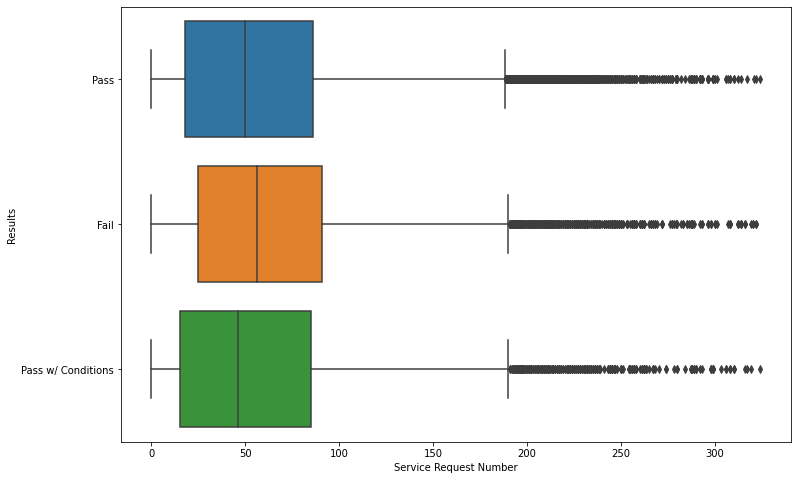

In [522]:
fig, ax = plt.subplots(figsize=(12,8))
sns.boxplot(data=main_df, x="Service Request Number", y="Results")

count how many recent(past 2 months) Rodent Complaints in surrounding area(same zipcode) of the establishments

In [523]:
rodent_df.head()

,Creation Date,Status,Completion Date,Service Request Number,Type of Service Request,Number of Premises Baited,Number of Premises with Garbage,Number of Premises with Rats,Current Activity,Most Recent Action,Street Address,ZIP Code,X Coordinate,Y Coordinate,Ward,Police District,Community Area,Latitude,Longitude,Location
0,10/07/2017,Completed,10/11/2017,17-06729970,Rodent Baiting/Rat Complaint,8.0,9.0,10.0,Dispatch Crew,Inspected and baited,851 N WASHTENAW AVE,60622.0,1.158237e+06,1.905660e+06,26.0,12.0,24.0,41.896879,-87.694267,"(41.896878696746, -87.694266619988)"
1,10/09/2017,Completed,10/11/2017,17-06758919,Rodent Baiting/Rat Complaint,1.0,1.0,1.0,Dispatch Crew,Inspected and baited,4167 W ADDISON ST,60641.0,1.147963e+06,1.923603e+06,30.0,17.0,16.0,41.946319,-87.731540,"(41.946318803266, -87.731539604209)"
2,10/09/2017,Completed,10/11/2017,17-06778528,Rodent Baiting/Rat Complaint,3.0,6.0,5.0,Dispatch Crew,Inspected and baited,4182 W NELSON ST,60641.0,1.147769e+06,1.919946e+06,31.0,25.0,21.0,41.936287,-87.732347,"(41.936287308164, -87.732347123808)"
3,10/09/2017,Completed,10/11/2017,17-06767810,Rodent Baiting/Rat Complaint,1.0,1.0,5.0,Dispatch Crew,Inspected and baited,2315 N MAPLEWOOD AVE,60647.0,1.158927e+06,1.915436e+06,1.0,14.0,22.0,41.923689,-87.691463,"(41.923689308781, -87.69146289107)"
4,07/31/2017,Completed,08/04/2017,17-05075019,Rodent Baiting/Rat Complaint,0.0,0.0,0.0,Dispatch Crew,"Area inspected, no cause and no baiting",1254 W BARRY AVE,60657.0,1.167392e+06,1.920715e+06,32.0,19.0,6.0,41.937997,-87.660207,"(41.937997161449, -87.660206674922)"


In [524]:
rodent_df["Creation Date"]=pd.to_datetime(rodent_df["Creation Date"])
print(max(rodent_df["Creation Date"]),min(rodent_df["Creation Date"]))
rodent_num_df=rodent_df.groupby(["ZIP Code","Creation Date"])["Service Request Number"].count().reset_index().sort_values(by=["ZIP Code","Creation Date"]).rename(columns={"Service Request Number":"Rodent complaints number"})
rodent_num_df.head(10)


2018-12-18 00:00:00 1999-11-29 00:00:00


,ZIP Code,Creation Date,Rodent complaints number
0,0.0,2011-07-13,1
1,0.0,2011-11-29,1
2,0.0,2017-11-28,1
3,60601.0,2011-02-19,1
4,60601.0,2011-04-13,1
5,60601.0,2011-04-14,1
6,60601.0,2011-05-03,1
7,60601.0,2011-05-18,2
8,60601.0,2011-06-14,1
9,60601.0,2011-08-19,1


In [525]:
rodent_num_df=rodent_num_df.groupby("ZIP Code").resample("D",on="Creation Date")["Rodent complaints number"].sum().reset_index()
rodent_num_df.set_index("Creation Date",inplace=True)
rodent_num_df=rodent_num_df.sort_index()
rodent_num_df=rodent_num_df.groupby(["ZIP Code"]).rolling("60D")["Rodent complaints number"].sum().reset_index()
rodent_num_df.head(20)

,ZIP Code,Creation Date,Rodent complaints number
0,0.0,2011-07-13,1.0
1,0.0,2011-07-14,1.0
2,0.0,2011-07-15,1.0
3,0.0,2011-07-16,1.0
4,0.0,2011-07-17,1.0
5,0.0,2011-07-18,1.0
6,0.0,2011-07-19,1.0
7,0.0,2011-07-20,1.0
8,0.0,2011-07-21,1.0
9,0.0,2011-07-22,1.0


In [526]:
main_df=pd.merge(main_df,rodent_num_df,left_on=["Zip","Inspection Date"],right_on=["ZIP Code","Creation Date"],how="left")
main_df=main_df.drop(columns=["ZIP Code","Creation Date"])

In [527]:
main_df[main_df["Rodent complaints number"].isna()]["Zip"].value_counts().head(10)

60606.0    126
60666.0     96
60601.0     49
60604.0     20
60603.0     19
60193.0     14
60007.0     12
60153.0     11
60653.0     11
60661.0      8
Name: Zip, dtype: int64

In [528]:
code_set_fillna={}
count=0
medianall=main_df["Rodent complaints number"].median()
for i in main_df[main_df["Rodent complaints number"].isna()]["Zip"].value_counts().index:
    if i not in rodent_num_df["ZIP Code"].unique():
        count+=1
        code_set_fillna[i]=medianall
    else:
        code_set_fillna[i]=0
print(count)
print(code_set_fillna)

37
{60606.0: 0, 60666.0: 0, 60601.0: 0, 60604.0: 0, 60603.0: 0, 60193.0: 94.0, 60007.0: 94.0, 60153.0: 94.0, 60653.0: 0, 60661.0: 0, 60602.0: 0, 60804.0: 94.0, 60126.0: 94.0, 60654.0: 0, 60611.0: 0, 60501.0: 94.0, 60077.0: 94.0, 60409.0: 94.0, 60201.0: 94.0, 60482.0: 94.0, 60302.0: 94.0, 60714.0: 94.0, 60607.0: 0, 60176.0: 94.0, 60406.0: 94.0, 60461.0: 94.0, 60659.0: 0, 60076.0: 94.0, 60107.0: 94.0, 60015.0: 94.0, 60411.0: 94.0, 60402.0: 94.0, 60540.0: 94.0, 60155.0: 94.0, 60637.0: 0, 60202.0: 94.0, 60453.0: 94.0, 60440.0: 94.0, 60047.0: 94.0, 60018.0: 94.0, 60148.0: 94.0, 60458.0: 94.0, 60022.0: 94.0, 60429.0: 94.0, 60423.0: 94.0, 60477.0: 94.0, 60478.0: 94.0, 60706.0: 94.0, 60108.0: 94.0, 60044.0: 94.0, 60827.0: 0}


In [529]:
values = code_set_fillna
main_df["Rodent complaints number"]=np.where(main_df["Rodent complaints number"].isna(),main_df["Zip"].map(values),main_df["Rodent complaints number"])
main_df=main_df.dropna(subset=["Zip"])

In [530]:
main_df.groupby(["Results"])["Rodent complaints number"].agg(["mean","median","std"])

,mean,median,std
Results,,,
Fail,130.436059,101.0,113.411763
Pass,124.405032,92.0,118.517408
Pass w/ Conditions,120.851674,82.0,121.846180


From the stats we could see as Rodent complaints reuqest number within the same area code as the establishments goes up, the inspection fail chance tend to increases.

<AxesSubplot:xlabel='Rodent complaints number', ylabel='Results'>

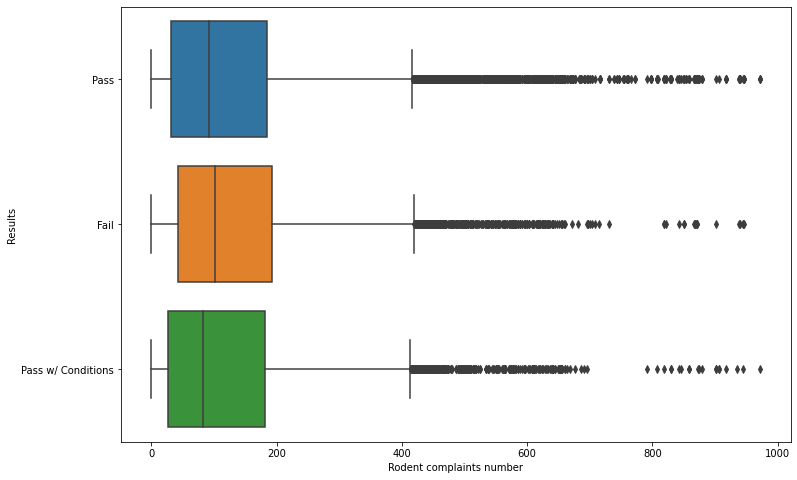

In [531]:
fig, ax = plt.subplots(figsize=(12,8))
sns.boxplot(data=main_df, x="Rodent complaints number", y="Results")

In [532]:
main_df.columns

Index(['DBA Name', 'AKA Name', 'Facility Type', 'Risk', 'Address', 'Zip',
       'Inspection Date', 'Inspection Type', 'Results', 'Violations',
       'Location', 'Violations_bool', 'violations_list', 'violations_len',
       'violations_tier_0', 'violations_tier_1', 'violations_tier_2',
       'Rolling_3_tmax', 'Service Request Number', 'Rodent complaints number'],
      dtype='object')

Generate columns for previous sum (previous all time window and previous 1 year window) of different violation tiers, previous fail count and length since last inspection

In [533]:
main_df=main_df.drop(columns=["violations_list","Violations","Location"])
print(len(main_df.drop_duplicates()),len(main_df))
main_df=main_df.drop_duplicates()
main_df.head()

115852 117304


,DBA Name,AKA Name,Facility Type,Risk,Address,Zip,Inspection Date,Inspection Type,Results,Violations_bool,violations_len,violations_tier_0,violations_tier_1,violations_tier_2,Rolling_3_tmax,Service Request Number,Rodent complaints number
0,MARRIOT MARQUIS CHICAGO,MARRIOT MARQUIS CHICAGO,Restaurant,Risk 1 (High),2121 S PRAIRIE AVE,60616.0,2017-08-28,License,Pass,0,0,0,0,0,78.3,39.0,94.0
1,MARRIOT MARQUIS CHICAGO,MARRIOT MARQUIS CHICAGO,Restaurant,Risk 1 (High),2121 S PRAIRIE AVE,60616.0,2017-08-28,License,Pass,1,2,0,0,2,78.3,39.0,94.0
2,CHARTWELLS,CICS WEST BELDEN CAMPUS,other,Risk 1 (High),2245 N MCVICKER AVE,60639.0,2017-08-28,License Re-Inspection,Pass,1,5,1,0,4,78.3,140.0,326.0
3,SHRIMP'S FISH CHICKEN,SHRIMP'S FISH CHICKEN,Restaurant,Risk 2 (Medium),4355 S COTTAGE GROVE AVE,60653.0,2017-08-28,License,Fail,1,12,0,5,6,78.3,45.0,45.0
4,ART'S DRIVE INN,ART'S DRIVE INN,Restaurant,Risk 1 (High),1333 W NORTH AVE,60622.0,2017-08-25,Canvass,Fail,1,8,2,1,4,75.7,107.0,346.0


In [534]:
main_df[["DBA Name","Address","Inspection Date","violations_tier_0","violations_tier_1","violations_tier_2"]].sort_values(by=["DBA Name","Address","Inspection Date"]).head(10)

,DBA Name,Address,Inspection Date,violations_tier_0,violations_tier_1,violations_tier_2
117235,#1 CHOP SUEY,1907 W 87TH ST,2011-01-05,0,1,5
84800,#1 CHOP SUEY,1907 W 87TH ST,2013-01-08,1,1,2
83825,#1 CHOP SUEY,1907 W 87TH ST,2013-01-22,1,0,2
71658,#1 CHOP SUEY,1907 W 87TH ST,2014-01-28,0,0,2
56504,#1 CHOP SUEY,1907 W 87TH ST,2014-05-22,0,0,1
50207,#1 CHOP SUEY,1907 W 87TH ST,2015-02-04,0,1,6
30857,#1 CHOP SUEY,1907 W 87TH ST,2016-01-26,0,0,3
117254,#1 CHOP SUEY,4307 W IRVING PARK RD,2011-01-05,0,0,3
110085,#1 CHOP SUEY,4307 W IRVING PARK RD,2011-06-03,0,0,3
99590,#1 CHOP SUEY,4307 W IRVING PARK RD,2012-04-24,0,1,6


In [535]:
#must exclude current violations otherwise result in data leakage
main_df=main_df.sort_values(by="Inspection Date")
main_df.groupby(["DBA Name","Address"]).rolling('3650D',on='Inspection Date',closed='left')[["violations_tier_0","violations_tier_1","violations_tier_2"]].sum().head(10)


violations_tier_0  \
DBA Name     Address                Inspection Date                      
#1 CHOP SUEY 1907 W 87TH ST         2011-01-05                     NaN   
                                    2013-01-08                     0.0   
                                    2013-01-22                     1.0   
                                    2014-01-28                     2.0   
                                    2014-05-22                     2.0   
                                    2015-02-04                     2.0   
                                    2016-01-26                     2.0   
             4307 W IRVING PARK RD  2011-01-05                     NaN   
                                    2011-06-03                     0.0   
                                    2012-04-24                     0.0   

                                                     violations_tier_1  \
DBA Name     Address                Inspection Date                      
#1 CHOP SUEY 1907 W 87TH ST         2011-01-05                     NaN   
                                    2013-01-08                     1.0   
                                    2013-01-22                     2.0   
                                    2014-01-28                     2.0   
                                    2014-05-22                     2.0   
                                    2015-02-04                     2.0   
                                    2016-01-26                     3.0   
             4307 W IRVING PARK RD  2011-01-05                     NaN   
                                    2011-06-03                     0.0   
                                    2012-04-24                     0.0   

                                                     violations_tier_2  
DBA Name     Address                Inspection Date                     
#1 CHOP SUEY 1907 W 87TH ST         2011-01-05                     NaN  
                                    2013-01-08                     5.0  
                                    2013-01-22                     7.0  
                                    2014-01-28                     9.0  
                                    2014-05-22                    11.0  
                                    2015-02-04                    12.0  
                                    2016-01-26                    18.0  
             4307 W IRVING PARK RD  2011-01-05                     NaN  
                                    2011-06-03                     3.0  
                                    2012-04-24                     6.0

In [536]:
main_df_10years=main_df.groupby(["DBA Name","Address"]).rolling('3650D',on='Inspection Date',closed='left')[["violations_tier_0","violations_tier_1","violations_tier_2"]].sum().reset_index()\
    .rename(columns={"violations_tier_0": "violations_tier_0_sum_10years", "violations_tier_1": "violations_tier_1_sum_10years", "violations_tier_2": "violations_tier_2_sum_10years"}).fillna(0)
main_df_1year=main_df.groupby(["DBA Name","Address"]).rolling('365D',on='Inspection Date',closed='left')[["violations_tier_0","violations_tier_1","violations_tier_2"]].sum().reset_index()\
    .rename(columns={"violations_tier_0": "violations_tier_0_sum_1year", "violations_tier_1": "violations_tier_1_sum_1year", "violations_tier_2": "violations_tier_2_sum_1year"}).fillna(0)


In [537]:
main_df["Fail"]=np.where(main_df["Results"]=="Fail",1,0)
main_df_fail_10years=main_df.groupby(["DBA Name","Address"]).rolling('3650D',on='Inspection Date',closed='left')[["Fail"]].sum().reset_index()\
    .rename(columns={"Fail": "Fail_count_10years"}).fillna(0)

In [538]:
main_df=main_df.sort_values(['DBA Name','Address','Inspection Date'])
main_df['time_since_last_inspection']=(main_df.sort_values(['DBA Name','Address','Inspection Date']).groupby(["DBA Name","Address"])["Inspection Date"].diff().fillna(pd.Timedelta(days=0)) / np.timedelta64(1, 'D')).astype(int)


In [539]:
main_df_10years=main_df_10years.groupby(['DBA Name','Address','Inspection Date'])[["violations_tier_0_sum_10years","violations_tier_1_sum_10years","violations_tier_2_sum_10years"]].sum().reset_index()
main_df_1year=main_df_1year.groupby(['DBA Name','Address','Inspection Date'])[["violations_tier_0_sum_1year","violations_tier_1_sum_1year","violations_tier_2_sum_1year"]].sum().reset_index()
main_df_fail_10years=main_df_fail_10years.groupby(['DBA Name','Address','Inspection Date'])[["Fail_count_10years"]].sum().reset_index()

In [540]:
main_df=pd.merge(main_df,main_df_10years,on=["DBA Name","Address","Inspection Date"],how="inner")
main_df=pd.merge(main_df,main_df_1year,on=["DBA Name","Address","Inspection Date"],how="inner")
main_df=pd.merge(main_df,main_df_fail_10years,on=["DBA Name","Address","Inspection Date"],how="inner")

In [541]:
main_df.columns

Index(['DBA Name', 'AKA Name', 'Facility Type', 'Risk', 'Address', 'Zip',
       'Inspection Date', 'Inspection Type', 'Results', 'Violations_bool',
       'violations_len', 'violations_tier_0', 'violations_tier_1',
       'violations_tier_2', 'Rolling_3_tmax', 'Service Request Number',
       'Rodent complaints number', 'Fail', 'time_since_last_inspection',
       'violations_tier_0_sum_10years', 'violations_tier_1_sum_10years',
       'violations_tier_2_sum_10years', 'violations_tier_0_sum_1year',
       'violations_tier_1_sum_1year', 'violations_tier_2_sum_1year',
       'Fail_count_10years'],
      dtype='object')

In [542]:
main_df.groupby(["Results"])[['time_since_last_inspection',"violations_tier_0_sum_10years","violations_tier_1_sum_10years","violations_tier_2_sum_10years"]].agg(["mean","median","std"])

time_since_last_inspection                     \
                                         mean median         std   
Results                                                            
Fail                               180.271719  137.0  204.772571   
Pass                               162.661005   51.0  201.640519   
Pass w/ Conditions                 215.407541  208.0  197.976881   

                   violations_tier_0_sum_10years                   \
                                            mean median       std   
Results                                                             
Fail                                    2.337485    0.0  4.293227   
Pass                                    2.162200    1.0  3.933825   
Pass w/ Conditions                      2.671929    1.0  4.368563   

                   violations_tier_1_sum_10years                    \
                                            mean median        std   
Results                                                              
Fail                                    2.277847    0.0  11.296286   
Pass                                    2.045609    1.0   8.736202   
Pass w/ Conditions                      2.566710    1.0   7.699942   

                   violations_tier_2_sum_10years                    
                                            mean median        std  
Results                                                             
Fail                                   13.692194    7.0  23.055089  
Pass                                   14.695321    8.0  36.412454  
Pass w/ Conditions                     15.901142   10.0  22.553521

Given above stats, longer the time since last inspection,  more likely it will not pass.    
More tier0 and tier1 violations accumulated during the years, more liekly it will not pass.   

Train test split and modelin, need to use time series split since our feature used past information:     
Since training on most recent observations which contains some past information and then inference on historical observations would lead to data leakage

In [184]:
final_df=main_df.drop(columns=["DBA Name","AKA Name","Address",'Zip','Violations_bool','violations_len','violations_tier_0', 'violations_tier_1',
       'violations_tier_2',"Fail"]).set_index("Inspection Date").sort_index()

In [185]:
final_df["Results"]=np.where(final_df["Results"]=="Pass w/ Conditions",1,np.where(final_df["Results"]=="Pass",2,0))

In [186]:
print(final_df["Risk"].unique())
#label encoded this with ranking of risk level
final_df["Risk"]=np.where(final_df["Risk"]=="Risk 1 (High)",3,np.where(final_df["Risk"]=="Risk 2 (Medium)",2,1))

['Risk 1 (High)' 'Risk 2 (Medium)' 'Risk 3 (Low)']


In [187]:
if os.path.exists("baseline_train.csv"):
    baseline_train=pd.read_csv("baseline_train.csv",date_parser="Inspection Date").set_index("Inspection Date")
else:
    baseline_train=final_df.iloc[:int(len(final_df)*0.8),:]
    baseline_train.reset_index().to_csv("baseline_train.csv",index=False)
if os.path.exists("baseline_test.csv"):
    baseline_test=pd.read_csv("baseline_test.csv",date_parser="Inspection Date").set_index("Inspection Date")
else:
    baseline_test=final_df.iloc[int(len(final_df)*0.8):,:]
    baseline_test.reset_index().to_csv("baseline_test.csv",index=False)
    
baseline_train_y=baseline_train["Results"]
baseline_train_X=baseline_train.drop(columns=["Results"])
baseline_test_y=baseline_test["Results"]
baseline_test_X=baseline_test.drop(columns=["Results"])

In [188]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import Pipeline
onehot_category_features=["Facility Type","Inspection Type"]
onehot_categorical_transformer=Pipeline(steps=[('onehot',OneHotEncoder(handle_unknown='ignore'))])
preprocessor=ColumnTransformer(transformers=[('onehot',onehot_categorical_transformer,onehot_category_features)],remainder='passthrough')

In [189]:
final_df.columns

Index(['Facility Type', 'Risk', 'Inspection Type', 'Results', 'Rolling_3_tmax',
       'Service Request Number', 'Rodent complaints number',
       'time_since_last_inspection', 'violations_tier_0_sum_10years',
       'violations_tier_1_sum_10years', 'violations_tier_2_sum_10years',
       'violations_tier_0_sum_1year', 'violations_tier_1_sum_1year',
       'violations_tier_2_sum_1year', 'Fail_count_10years'],
      dtype='object')

first interation of tree model only used to test baseline and drop unimportant feature based on feature importances

In [190]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
model = RandomForestRegressor(n_estimators=100, random_state=42)
my_pipeline = Pipeline(steps=[('preprocessor', preprocessor),('model',model)])
my_pipeline.fit(baseline_train_X,baseline_train_y)
preds = my_pipeline.predict(baseline_test_X)
print('MAE:', mean_absolute_error(baseline_test_y, preds))
print('MSE:', mean_squared_error(baseline_test_y, preds))

MAE: 0.6672527838489963
MSE: 0.6386573243778713


In [191]:
print(my_pipeline[0].get_feature_names_out(['Facility Type', 'Risk', 'Inspection Type', 'Rolling_3_tmax',
       'Service Request Number', 'Rodent complaints number', 'time_since_last_inspection',
       'violations_tier_0_sum_10years', 'violations_tier_1_sum_10years',
       'violations_tier_2_sum_10years', 'violations_tier_0_sum_1year',
       'violations_tier_1_sum_1year', 'violations_tier_2_sum_1year',
       'Fail_count_10years']))
feature_names=my_pipeline[0].get_feature_names_out(['Facility Type', 'Risk', 'Inspection Type', 'Rolling_3_tmax',
       'Service Request Number', 'Rodent complaints number', 'time_since_last_inspection',
       'violations_tier_0_sum_10years', 'violations_tier_1_sum_10years',
       'violations_tier_2_sum_10years', 'violations_tier_0_sum_1year',
       'violations_tier_1_sum_1year', 'violations_tier_2_sum_1year',
       'Fail_count_10years'])
print(my_pipeline[-1].feature_importances_)
#the first 16 features are one hot encoded features
feature_importances=my_pipeline[-1].feature_importances_
feature_importances_df=pd.DataFrame(feature_importances,index=feature_names,columns=["importance"]).sort_values(by="importance",ascending=False)
feature_importances_df

['onehot__Facility Type_Bakery'
 "onehot__Facility Type_Children's Services Facility"
 'onehot__Facility Type_Daycare (2 - 6 Years)'
 'onehot__Facility Type_Daycare Above and Under 2 Years'
 'onehot__Facility Type_Grocery Store' 'onehot__Facility Type_Restaurant'
 'onehot__Facility Type_School' 'onehot__Facility Type_other'
 'onehot__Inspection Type_Canvass'
 'onehot__Inspection Type_Canvass Re-Inspection'
 'onehot__Inspection Type_Complaint'
 'onehot__Inspection Type_Complaint Re-Inspection'
 'onehot__Inspection Type_License'
 'onehot__Inspection Type_License Re-Inspection'
 'onehot__Inspection Type_Short Form Complaint'
 'onehot__Inspection Type_other' 'remainder__Risk'
 'remainder__Rolling_3_tmax' 'remainder__Service Request Number'
 'remainder__Rodent complaints number'
 'remainder__time_since_last_inspection'
 'remainder__violations_tier_0_sum_10years'
 'remainder__violations_tier_1_sum_10years'
 'remainder__violations_tier_2_sum_10years'
 'remainder__violations_tier_0_sum_1year'


,importance
remainder__Rolling_3_tmax,0.183107
remainder__Rodent complaints number,0.176031
remainder__Service Request Number,0.160792
remainder__time_since_last_inspection,0.118073
remainder__violations_tier_2_sum_10years,0.070097
remainder__violations_tier_2_sum_1year,0.040008
remainder__Fail_count_10years,0.031580
remainder__violations_tier_1_sum_10years,0.029517
remainder__violations_tier_0_sum_10years,0.027374
onehot__Inspection Type_Canvass Re-Inspection,0.025001


Turns out "the average highest temperature of past three days", "the sanitation compliant in surrounding neighborhood(same zipcode)" and "the rodents compliant in surrounding neighborhood(same zipcode)" contributes a lot in terms of model predictability

Official modeling, hyperparamter tuning and model explainability 

In [202]:
import xgboost as xgb
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV

model = xgb.XGBRegressor(random_state=42)
tscv = TimeSeriesSplit(n_splits=2)
path = 'xgboost_model.json'
if os.path.exists(path):
    model.load_model(path)
    my_pipeline = Pipeline(steps=[('preprocessor', preprocessor),('model',model)])
    preds = my_pipeline.predict(baseline_test_X)
else:
    my_pipeline = Pipeline(steps=[('preprocessor', preprocessor),('model',model)])
    param_search = {'model__learning_rate':[0.2,0.3],'model__max_depth' : list(range(3,7)),'model__subsample':[0.5,0.6,0.7,0.8,1],'model__lambda':[1,1.1,1.2,1.3]}
    gsearch = GridSearchCV(estimator=my_pipeline, cv=tscv,
                            param_grid=param_search)
    gsearch.fit(baseline_train_X,baseline_train_y)
    print(gsearch.best_params_)
    preds = gsearch.best_estimator_.predict(baseline_test_X)
    #save the best model
    gsearch.best_estimator_[-1].save_model("xgboost_model.json")

{'model__lambda': 1.2, 'model__learning_rate': 0.2, 'model__max_depth': 3, 'model__subsample': 1}


In [203]:
print('MAE:', mean_absolute_error(baseline_test_y, preds))
print('MSE:', mean_squared_error(baseline_test_y, preds))
pred_df=pd.DataFrame({"preds":preds,"actual":baseline_test_y})

MAE: 0.6573216979909605
MSE: 0.6133142870254219


In [204]:
#MAE for "Fail" subset
print('MAE:', mean_absolute_error(pred_df[pred_df["actual"]==0]["actual"], pred_df[pred_df["actual"]==0]["preds"]))
#MAE for "Pass w/ Conditions" subset
print('MAE:', mean_absolute_error(pred_df[pred_df["actual"]==1]["actual"], pred_df[pred_df["actual"]==1]["preds"]))
#MAE for "Pass" subset
print('MAE:', mean_absolute_error(pred_df[pred_df["actual"]==2]["actual"], pred_df[pred_df["actual"]==2]["preds"]))

MAE: 1.2819279124351026
MAE: 0.4164063850954871
MAE: 0.49126351906208887


In [205]:
import joblib
import pickle
def save_model(model, model_filepath):
    """
    Save model to a pickle file
    Args:
        model: model object
        model_filepath: path to save the model
    Returns:
        None
    """
    pickle.dump(model, open(model_filepath, 'wb'))

model2 = RandomForestRegressor(n_estimators=100, random_state=42)
path = 'randomforest_model.pkl'
if os.path.exists(path):
    model2 = joblib.load(path)
    my_pipeline2 = Pipeline(steps=[('preprocessor', preprocessor),('model',model2)])
    preds2 = my_pipeline2.predict(baseline_test_X)
else:
    my_pipeline2 = Pipeline(steps=[('preprocessor', preprocessor),('model',model2)])
    param_search2 = {"model__max_features": [0.2,0.4,0.6],
                    "model__max_samples": [0.2,0.4,0.6,0.8,1.0],
                    "model__n_estimators": [100,200,300]}
    gsearch2 = GridSearchCV(estimator=my_pipeline2, cv=tscv,
                            param_grid=param_search2)
    gsearch2.fit(baseline_train_X,baseline_train_y)
    print(gsearch2.best_params_)
    preds2 = gsearch2.best_estimator_.predict(baseline_test_X)
    save_model(gsearch2.best_estimator_[-1],"randomforest_model.pkl")


{'model__max_features': 0.2, 'model__max_samples': 0.2, 'model__n_estimators': 300}


In [206]:
print('MAE:', mean_absolute_error(baseline_test_y, preds2))
print('MSE:', mean_squared_error(baseline_test_y, preds2))
pred_df2=pd.DataFrame({"preds":preds2,"actual":baseline_test_y})
#MAE for "Fail" subset
print('MAE:', mean_absolute_error(pred_df2[pred_df2["actual"]==0]["actual"], pred_df2[pred_df2["actual"]==0]["preds"]))
#MAE for "Pass w/ Conditions" subset
print('MAE:', mean_absolute_error(pred_df2[pred_df2["actual"]==1]["actual"], pred_df2[pred_df2["actual"]==1]["preds"]))
#MAE for "Pass" subset
print('MAE:', mean_absolute_error(pred_df2[pred_df2["actual"]==2]["actual"], pred_df2[pred_df2["actual"]==2]["preds"]))


MAE: 0.663309423425506
MSE: 0.6153870816082714
MAE: 1.251990318881966
MAE: 0.3834611829063884
MAE: 0.5166978130550522


In [207]:
from sklearn.linear_model import ElasticNet
from sklearn.preprocessing import StandardScaler
model3 = ElasticNet(random_state=42)
all_features=['onehot__Facility Type_Bakery',
 "onehot__Facility Type_Children's Services Facility",
 'onehot__Facility Type_Daycare (2 - 6 Years)',
 'onehot__Facility Type_Daycare Above and Under 2 Years',
 'onehot__Facility Type_Grocery Store', 'onehot__Facility Type_Restaurant',
 'onehot__Facility Type_School', 'onehot__Facility Type_other',
 'onehot__Inspection Type_Canvass',
 'onehot__Inspection Type_Canvass Re-Inspection',
 'onehot__Inspection Type_Complaint',
 'onehot__Inspection Type_Complaint Re-Inspection',
 'onehot__Inspection Type_License',
 'onehot__Inspection Type_License Re-Inspection',
 'onehot__Inspection Type_Short Form Complaint',
 'onehot__Inspection Type_other', 'remainder__Risk',
 'remainder__Rolling_3_tmax', 'remainder__Service Request Number','remainder__Rodent complaints number',
 'remainder__time_since_last_inspection',
 'remainder__violations_tier_0_sum_10years',
 'remainder__violations_tier_1_sum_10years',
 'remainder__violations_tier_2_sum_10years',
 'remainder__violations_tier_0_sum_1year',
 'remainder__violations_tier_1_sum_1year',
 'remainder__violations_tier_2_sum_1year', 'remainder__Fail_count_10years']
standardScaler_transformer=Pipeline(steps=[('standardScaler',StandardScaler())])
preprocessor2=ColumnTransformer(transformers=[('standardScaler',standardScaler_transformer,list(range(len(all_features))))])
path = 'elasticnet_model.pkl'
if os.path.exists(path):
    model3 = joblib.load(path)
    my_pipeline3 = Pipeline(steps=[('preprocessor', preprocessor),('scaler',preprocessor2),('model',model3)])
    my_pipeline3[:-1].fit(baseline_train_X)
    preds3 = my_pipeline3.predict(baseline_test_X)
else:
    my_pipeline3 = Pipeline(steps=[('preprocessor', preprocessor),('scaler',preprocessor2),('model',model3)])
    param_search3 = {"model__alpha": [0.001,0.005,0.007,0.01,0.1],
                    "model__l1_ratio": [0.6,0.7,0.8,0.85,0.9,1.0]}
    gsearch3 = GridSearchCV(estimator=my_pipeline3, cv=tscv,
                            param_grid=param_search3)
    gsearch3.fit(baseline_train_X,baseline_train_y)
    print(gsearch3.best_params_)
    preds3 = gsearch3.best_estimator_.predict(baseline_test_X)
    save_model(gsearch3.best_estimator_[-1],"elasticnet_model.pkl")

{'model__alpha': 0.005, 'model__l1_ratio': 0.7}


In [208]:
print('MAE:', mean_absolute_error(baseline_test_y, preds3))
print('MSE:', mean_squared_error(baseline_test_y, preds3))
pred_df3=pd.DataFrame({"preds":preds3,"actual":baseline_test_y})
#MAE for "Fail" subset
print('MAE:', mean_absolute_error(pred_df3[pred_df3["actual"]==0]["actual"], pred_df3[pred_df3["actual"]==0]["preds"]))
#MAE for "Pass w/ Conditions" subset
print('MAE:', mean_absolute_error(pred_df3[pred_df3["actual"]==1]["actual"], pred_df3[pred_df3["actual"]==1]["preds"]))
#MAE for "Pass" subset
print('MAE:', mean_absolute_error(pred_df3[pred_df3["actual"]==2]["actual"], pred_df3[pred_df3["actual"]==2]["preds"]))

MAE: 0.6863356731567498
MSE: 0.64462453371603
MAE: 1.3534887023479498
MAE: 0.41994239173318104
MAE: 0.5106656517113255


Modeling conclusion:    
    
1. After above modeling experimentation, we could see almost all models have similiar performances with xgboost performs a little better than the rest,    
Fail MAE: 1.2819279124351026   
Pass with condition MAE: 0.4164063850954871    
Pass MAE: 0.49126351906208887     
thus stacking or voting may not increase the model performance for a significant range even if conducted.    
   
2. Overall by observing MAE for each subset, models tend to perform better on "Pass" and "Pass w/ Conditions" subsets.     

1.5 is the midpoint between "Pass" and "Pass w/ Conditions", and 0.5 is the midpoint between "Pass w/ Conditions" and "Fail"       
   
We labeled "Pass" as 2 and it is MAE is 0.491, 2-0.491>1.5>1>0,    
it means on average the model could differentiate "Pass" from "Pass w/ Conditions", and really good at differentiate "Pass" from "Fail"    
We labeled "Pass w/ Conditions" as 1 and it is MAE is 0.416, 2>1.5>1+0.416>1>1-0.416>0.5>0,    
it means on average the model could differentiate "Pass w/ Conditions" from "Pass", and could also differentiate "Pass w/ Conditions" from "Fail"     
We labeled "Fail" as 0 and it is MAE is 1.28, 2>1.5>0+1.28>1,    
it means on average the model is hard to differentiate "Fail" from "Pass w/ Conditions", but could differentiate "Fail" from "Pass" wtih ease        






Model explainability using Shapley value and partial dependency plots

In [209]:
finalmodel=xgb.XGBRegressor(random_state=42)
finalmodel.load_model("xgboost_model.json")
final_pipeline = Pipeline(steps=[('preprocessor', preprocessor),('model',finalmodel)])

In [210]:
feature_names=final_pipeline[0].get_feature_names_out(['Facility Type', 'Risk', 'Inspection Type', 'Rolling_3_tmax',
       'Service Request Number', 'Rodent complaints number','time_since_last_inspection',
       'violations_tier_0_sum_10years', 'violations_tier_1_sum_10years',
       'violations_tier_2_sum_10years', 'violations_tier_0_sum_1year',
       'violations_tier_1_sum_1year', 'violations_tier_2_sum_1year',
       'Fail_count_10years'])
#the first 16 features are one hot encoded features
feature_importances=final_pipeline[-1].feature_importances_
feature_importances_df=pd.DataFrame(feature_importances,index=feature_names,columns=["importance"]).sort_values(by="importance",ascending=False)
feature_importances_df

,importance
onehot__Inspection Type_Canvass Re-Inspection,0.370148
onehot__Inspection Type_Complaint,0.145047
onehot__Inspection Type_License,0.086412
onehot__Inspection Type_Canvass,0.059975
onehot__Inspection Type_License Re-Inspection,0.041730
onehot__Inspection Type_Complaint Re-Inspection,0.032637
remainder__time_since_last_inspection,0.032292
remainder__violations_tier_0_sum_10years,0.025454
remainder__Fail_count_10years,0.025441
onehot__Inspection Type_other,0.023540


In [211]:
feature_importances_df.index[:10]

Index(['onehot__Inspection Type_Canvass Re-Inspection',
       'onehot__Inspection Type_Complaint', 'onehot__Inspection Type_License',
       'onehot__Inspection Type_Canvass',
       'onehot__Inspection Type_License Re-Inspection',
       'onehot__Inspection Type_Complaint Re-Inspection',
       'remainder__time_since_last_inspection',
       'remainder__violations_tier_0_sum_10years',
       'remainder__Fail_count_10years', 'onehot__Inspection Type_other'],
      dtype='object')

By oberserving related partial dependency plots, could draw the following insights:    

1. If "Inspection Type" is realted to re-inspection, then the establishments have higher chance to pass, this is intuitive since people tend to value their "second chance" and correct past mistakes for the incoming re-inspection      

2. Service facilities envolving kids and children like Daycare, children service facility and school tend to have higher change to pass, this might due to reason that these facilities are realted to children thus have higher sense of responsibilities and also potentially under supervision of parents.    

3. For "time since last inspection", the partial dependcy plot shows the tendency to pass first increases as time span increase but really soon the tendency to pass start and continue to decease as time span increases. It is intuitive since when time is too short between two inspections(likely the later one is re-inspection), it is hard for the establishments to correct its mistake on time. But as time span increases, establishments tend to cut slack since lack of supervision and guidance, thus tend to fail with an inspection that hasn't happened for years.    

4. The more service request number (sanitation compliants) happened at the same zip code area with the establishments during past 60 days, the more likely the inspection ended up failing. Since bad sanitation condition of the neighborhood may affect the establishments.    

5. The higher the average highest temperature of past 2 days including today(3 days in total), more likely the establishments will fail. Since the violation codes listed lot of temperature related problems, most of them are about food quality under improper temerature. The higher the outside temperature is, the harder it is for staff at establishments to prevent food quality decay.    

6. Past Tier0 violation counts is important since tier0 code violations are serious code violations and lead to high inspection fail rates. Thus the more an establishments accumulate this kind of violations during the years, the less likely it will pass an inspection. The inspector may be more catious due to the establishments past serious violations' history   

7. what is weird is that as number of rodents compliants goes up in the same zip code area surrounding the establishments , the establishments tend to pass an inspection while intuitively it might fail since the establishment may get affected by its environment.      
One possible explaination may be that since such rodents problems are being discovered by government through compliants, then the government would focus more on the problem and send people to fix the issue and kill the rodents. Thus allieviate the rodents problems. 


c:\Python38\lib\site-packages\sklearn\inspection\_plot\partial_dependence.py:1448: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, ax = plt.subplots()


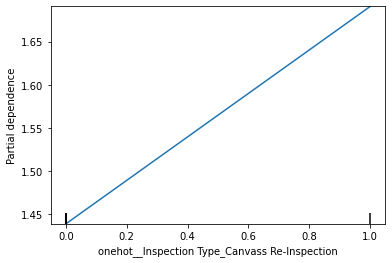

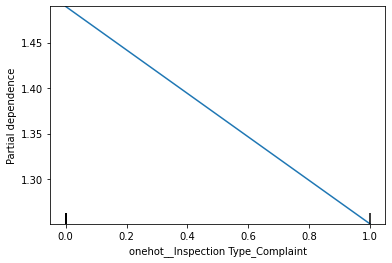

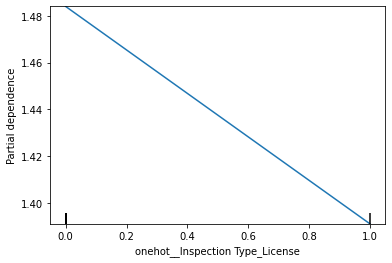

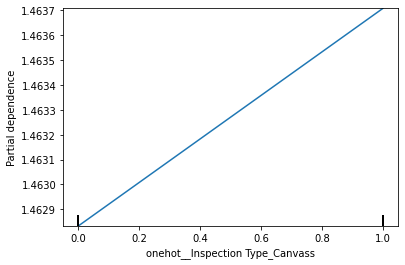

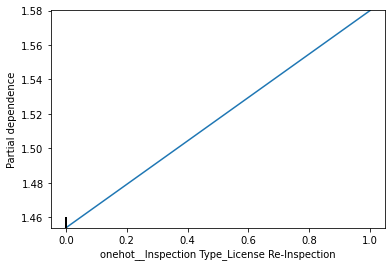

...

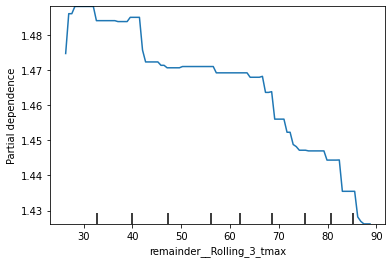

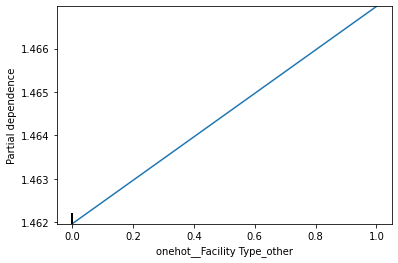

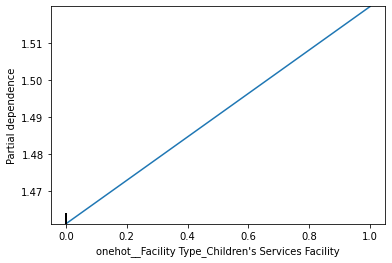

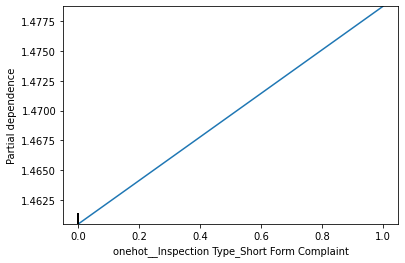

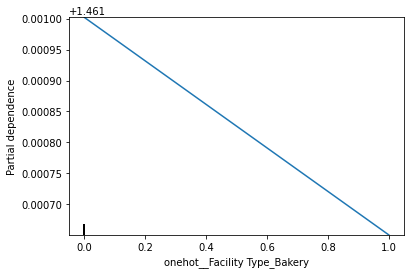

In [212]:
from sklearn.inspection import PartialDependenceDisplay
for i in feature_importances_df.index[:30]:
    index=all_features.index(i)
    features = [index]
    PartialDependenceDisplay.from_estimator(finalmodel, pd.DataFrame(final_pipeline[0].fit_transform(baseline_train_X),columns=feature_names), features)